# Advanced Lane Line Project
The goal of this project is to write a software pipeline to identify the lane boundaries in a video. In order to do so, the following steps will by applyied:

1. compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
2. apply a distortion correction to raw images.
3. use color transforms, gradients, etc., to create a thresholded binary image.
4. apply a perspective transform to rectify binary image ("birds-eye view").
5. detect lane pixels and fit to find the lane boundary.
6. determine the curvature of the lane and vehicle position with respect to center.
7. warp the detected lane boundaries back onto the original image.
8. output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

from Camera import Camera
from Thresholds import Thresholds
from BirdEyeView_Transform import BirdEyeView_Transform
from Lanes import Lanes

%matplotlib inline

## Utilities
`print_images` takes as input a string representing a folder and print all the images inside that folder

In [2]:
def print_images(folder, columns = 2):
    images = glob.glob(folder + '/*.jpg')
    if (len(images) % columns) == 0:
        rows = len(images)//columns
    else:
        rows = (len(images) + 1)//columns
    f, axes = plt.subplots(rows, columns, figsize=(40,110))
    i = 0
    for fname in images:
        img = cv2.imread(fname)
        axes.flat[i].imshow(img)
        axes.flat[i].set_title(fname, fontsize=40)
        i += 1
    if (len(images) % columns) != 0:
        f.delaxes(axes[-1][-1])
    plt.show()

`plot_image` takes an image and plot it

In [3]:
def plot_image(img, title='Image'):
    f, ax = plt.subplots(1, 1, figsize=(12,9))
    ax.imshow(img, cmap='gray')
    ax.set_title(title, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

`draw_lines_on_road` draws the lane found with all the calculation back on the original image

In [4]:
def draw_lines_on_road(original_image, binary_warped):
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    h,w = binary_warped.shape
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = b.unwarp(color_warp)
    # Combine the result with the original image
    result = cv2.addWeighted(original_image, 1, newwarp, 0.5, 0)
    return result

`draw_overlay` draws curvature and distance on the image given in input

In [ ]:
def draw_overlay(image, curvature, distance):
    font = cv2.FONT_HERSHEY_DUPLEX
    cv2.putText(image,"Radius of Curvature:  "+ '{:6.2f}m'.format(curvature), (10, 50), font, 1.0,[255, 255, 255], 1, cv2.LINE_AA)
    if distance > 0:
        cv2.putText(image,"Vehicle is " + '{:6.2f}m'.format(distance) + " right of center", (10, 100), font, 1.0,[255, 255,255], 1, cv2.LINE_AA)
    else:
        cv2.putText(image,"Vehicle is " + '{:6.2f}m'.format(distance) + " left of center", (10, 100), font, 1.0,[255, 255, 255], 1, cv2.LINE_AA)
    return image

Useful constants

In [13]:
OUTPUT_FOLDER = 'output_images'

## 1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images

In order to undistort the images, first we need the camera calibration matrix and distortion coefficient. These are found by taking pictures of a chessboard (in our case a 9x6 chessboard) and then applying the function `cv2.calibrateCamera`. 
The chessboard images can be found in the folder `camera_cal`. 
Note that some images are not perfect, and the chessboard is 'cut', thus the function `cv2.findChessboardCorners` cannot find all the corners. All the code that calibrates the camera, and also the function that undistort the image that we are going to use in point 2, can be found in the Python class `Camera` (defined in Camera.py)

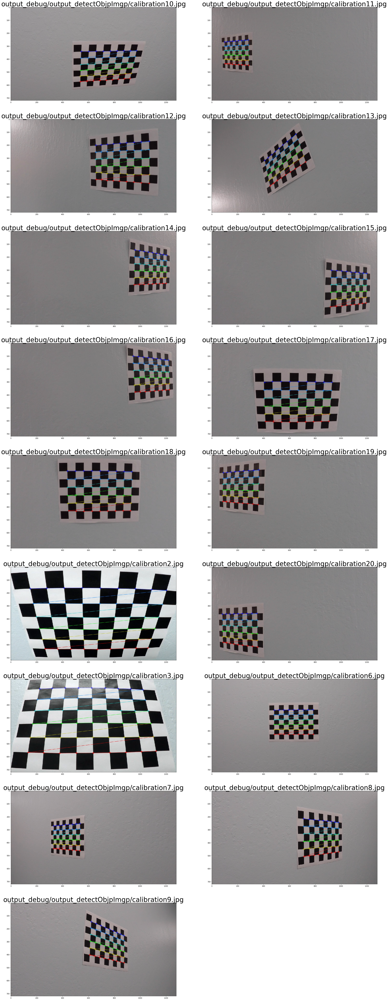

In [78]:
# Uncomment next to test camera calibration
c = Camera()
c.calibrate(debug=True)
axes = print_images(f'{OUTPUT_FOLDER}/output_detectObjpImgp')

## 2. Apply a distortion correction to raw images
Call Camera's method `undistort` to undistort images.
Function `debug_undistort` simply call `undistort` method an all the calibration images, while `test_undistort` call the method an all the test images.

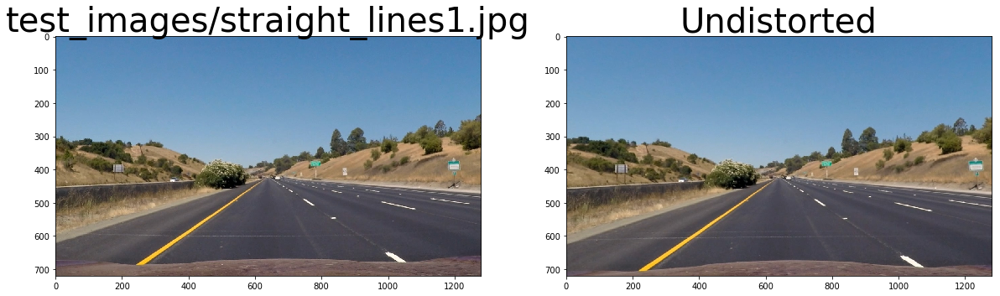

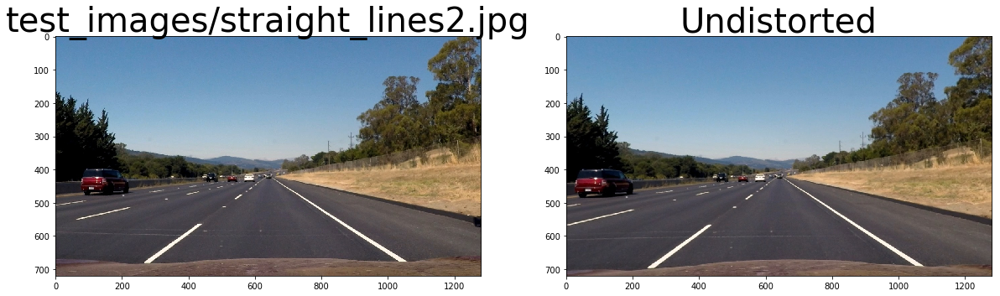

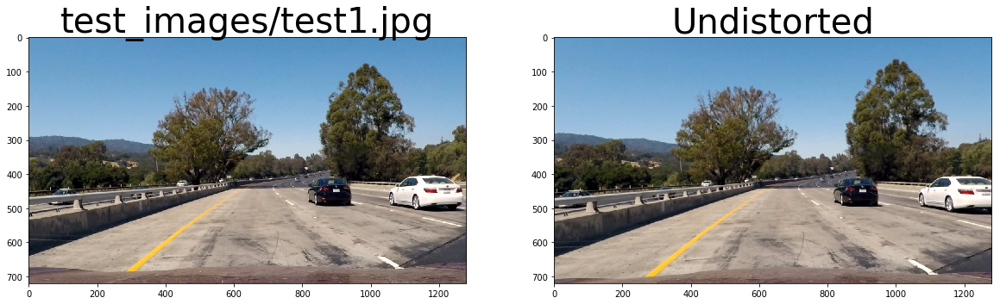

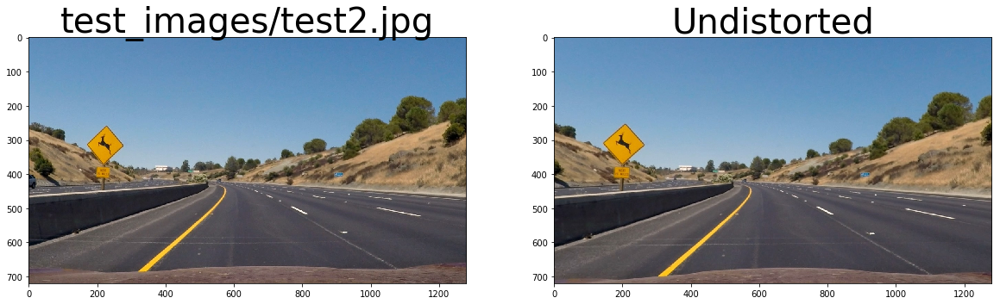

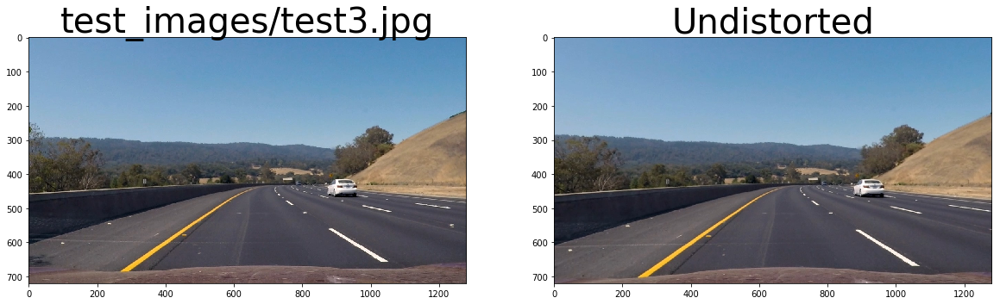

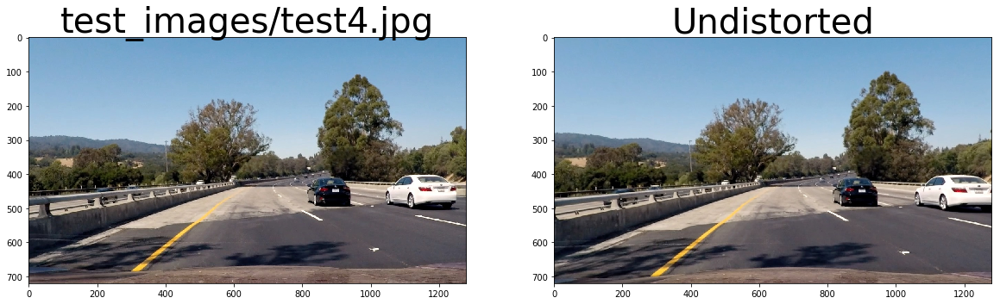

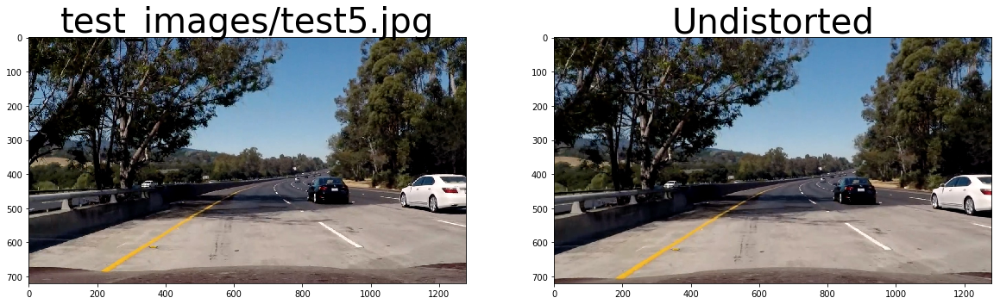

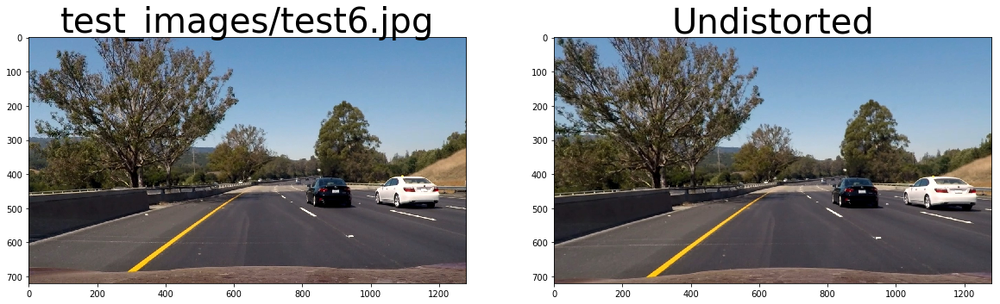

In [27]:
def debug_undistort():
    c = Camera()
    c.calibrate()
    camera_images = glob.glob('camera_cal/*.jpg')
    for fname in camera_images:
        img = cv2.imread(fname)
        undistorted = c.undistort(img)
        outfname = fname.replace('camera_cal', f'{OUTPUT_FOLDER}/output_undistorted')
        f, axes = plt.subplots(1, 2, figsize=(20,10))
        axes.flat[0].imshow(img)
        axes.flat[0].set_title(fname, fontsize=40)
        axes.flat[1].imshow(undistorted)
        axes.flat[1].set_title('Undistorted', fontsize=40)
        cv2.imwrite(outfname, undistorted)
        confront_out = fname.replace('camera_cal', f'{OUTPUT_FOLDER}/confront_undistorted')
        f.savefig(confront_out)
        
def test_undistort():
    c = Camera()
    c.calibrate()
    camera_images = glob.glob('test_images/*.jpg')
    for fname in camera_images:
        img = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
        undistorted = c.undistort(img)
        outfname = fname.replace('test_images', f'{OUTPUT_FOLDER}/test_undistorted')
        cv2.imwrite(outfname, cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
        
        f, axes = plt.subplots(1, 2, figsize=(20,10))
        axes.flat[0].imshow(img)
        axes.flat[0].set_title(fname, fontsize=40)
        axes.flat[1].imshow(undistorted)
        axes.flat[1].set_title('Undistorted', fontsize=40)
        confront_out = fname.replace('test_images', f'{OUTPUT_FOLDER}/test_undistorted_confront')
        f.savefig(confront_out)
        
# Uncomment to try undistortion
# debug_undistort()
# test_undistort()

## 3. Use color transforms, gradients, etc., to create a thresholded binary image
Class Thresholds (defined in Thresholds.py) is a class that let the user extract features from the image by thresholding Sobel, HLS Colorspace and others. The main function is `combine` that, as the name suggests, combines all the features selected so as to create a thresholded binary image.

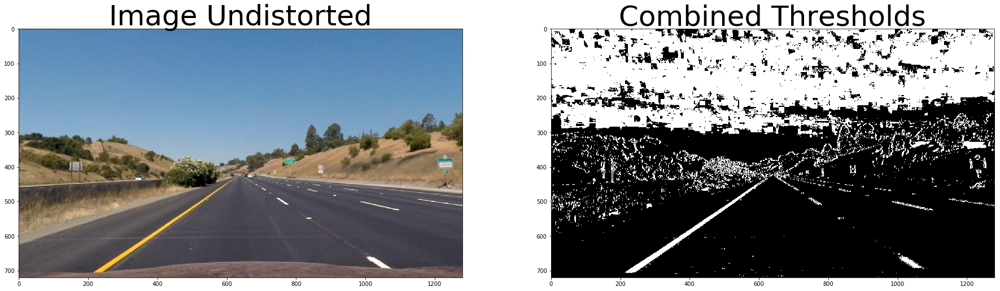

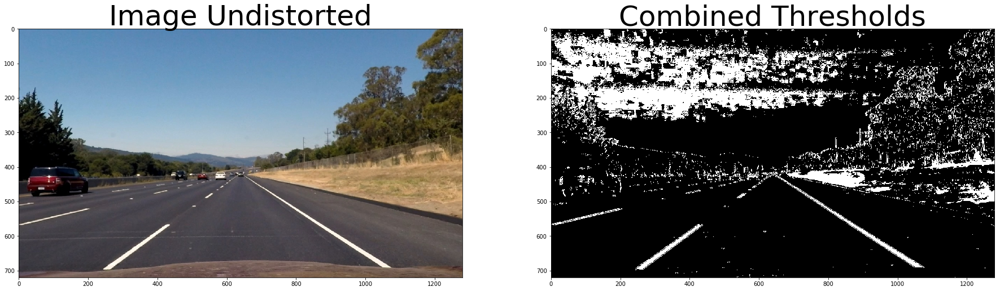

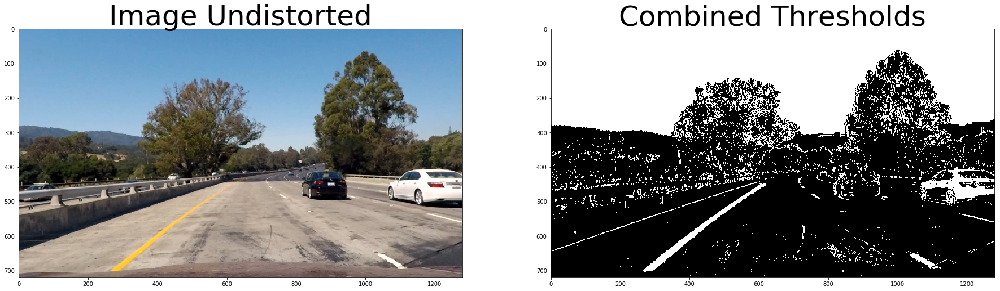

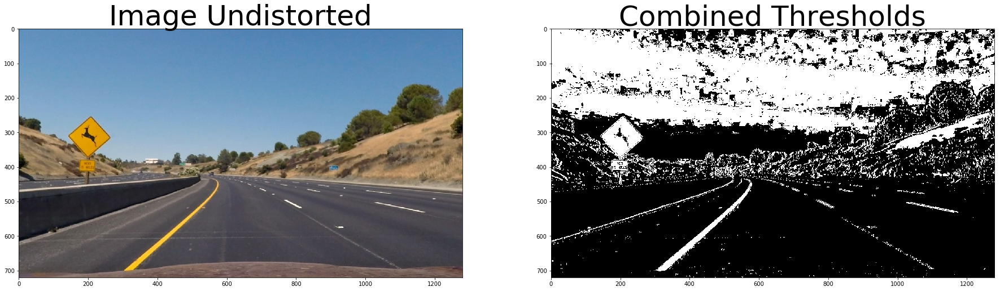

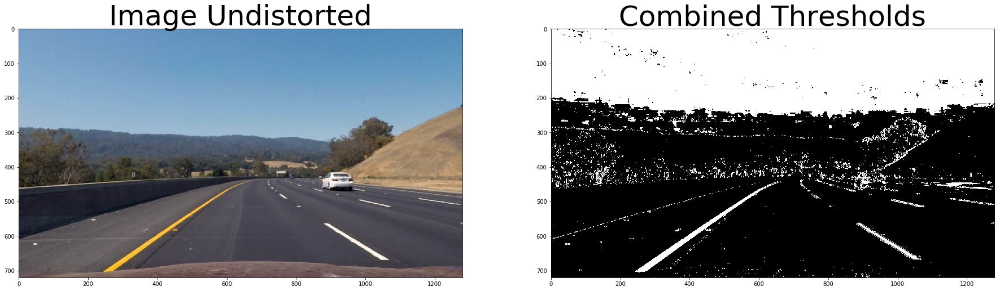

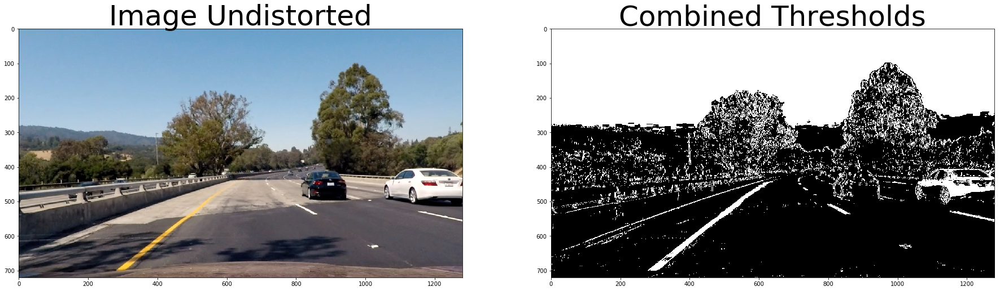

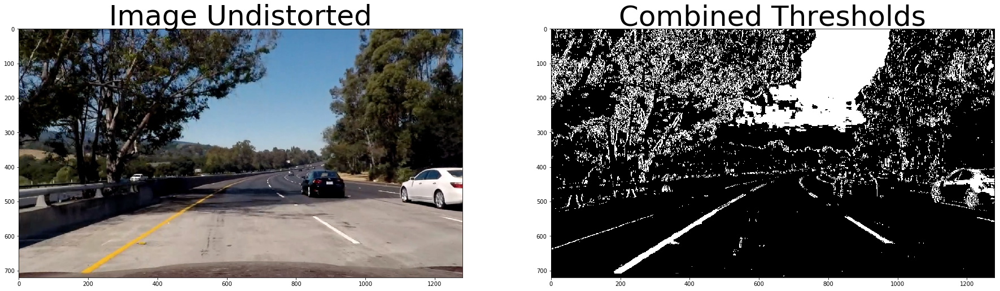

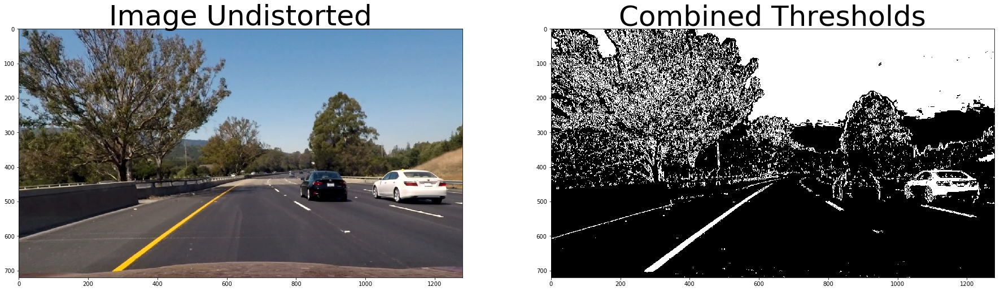

In [31]:
c = Camera()
c.calibrate()
t = Thresholds()
images = glob.glob('test_images/*.jpg') 

for index, fname in enumerate(images):
    image = c.undistort(cv2.imread(fname))
    combined = t.combine(image)
    
    outfname = fname.replace('test_images', f'{OUTPUT_FOLDER}/test_binary_threshold')
    cv2.imwrite(outfname, combined*255)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Undistorted', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Combined Thresholds', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()


## 4. Apply a perspective transform to rectify binary image ("birds-eye view")

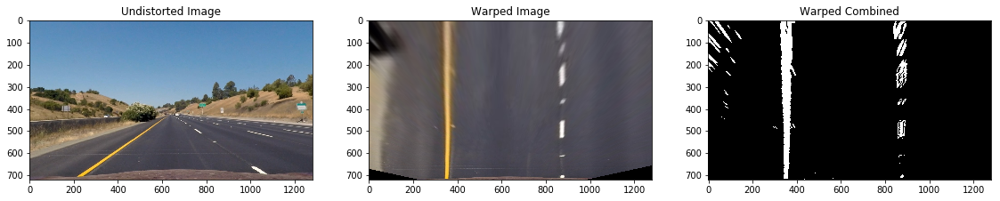

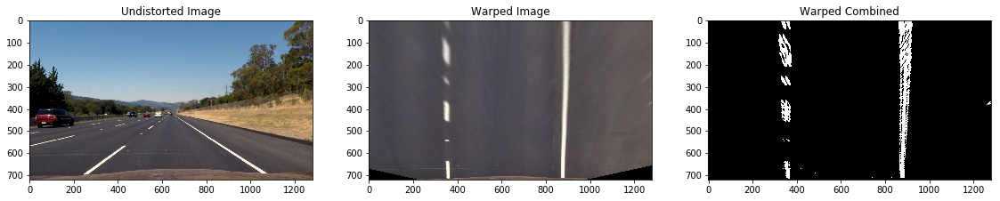

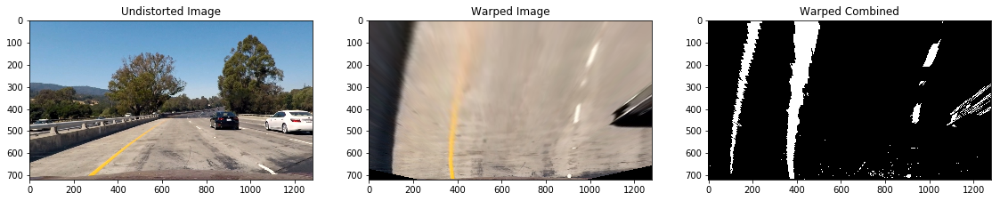

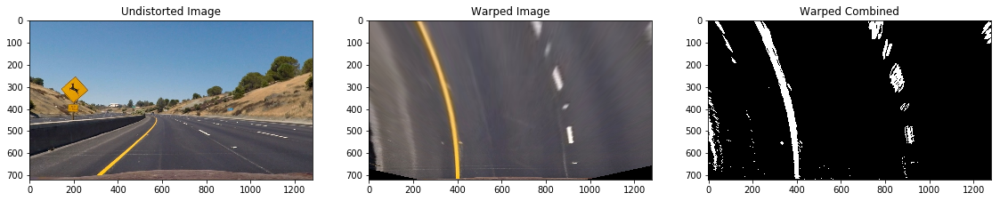

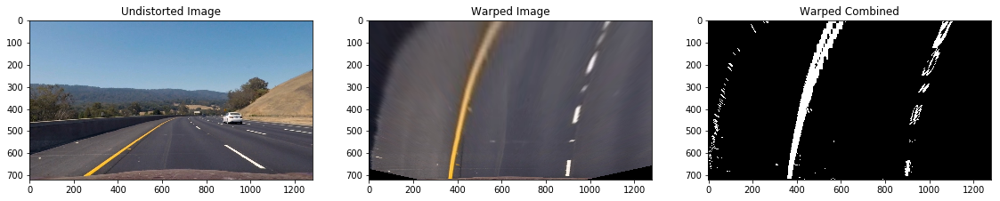

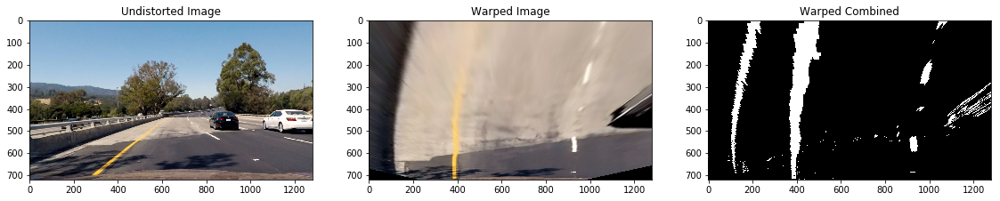

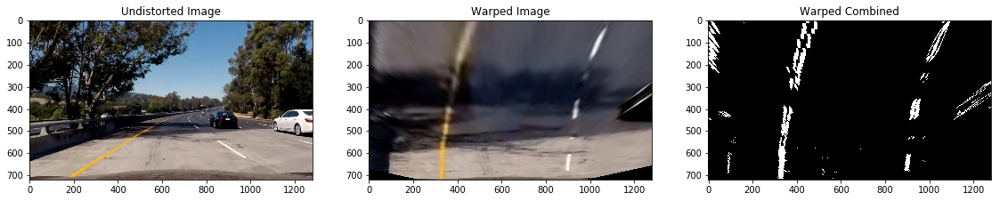

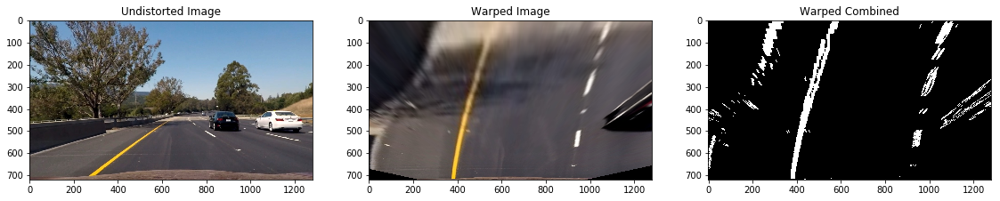

In [17]:
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()

for index, fname in enumerate(images):
    
    original_image = cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)
    undistorted = c.undistort(original_image)
    warped = b.warp(undistorted)
    
    combined = t.combine(undistorted)
    warped_combined = b.warp(combined)
    
    outfname = fname.replace('test_images', f'{OUTPUT_FOLDER}/test_bird_eye_view')
    cv2.imwrite(outfname, cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 30))
    ax1.imshow(undistorted)
    ax1.set_title('Undistorted Image')
    ax2.imshow(warped)
    ax2.set_title('Warped Image')
    ax3.imshow(warped_combined, cmap='gray')
    ax3.set_title('Warped Combined')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

## 5. Detect lane pixels and fit to find the lane boundary

Fname  test_images/straight_lines1.jpg


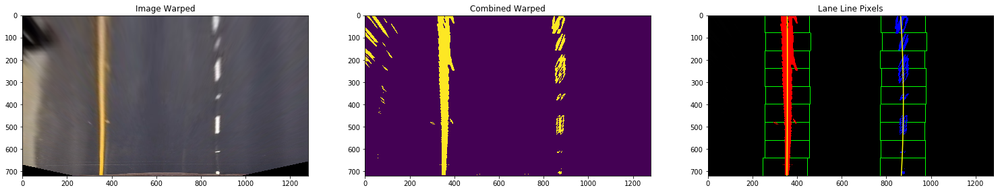

Fname  test_images/straight_lines1.jpg


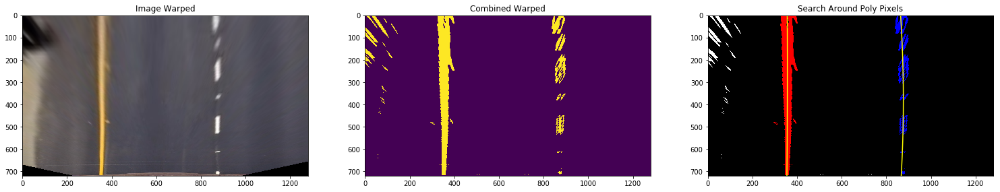

Fname  test_images/straight_lines2.jpg


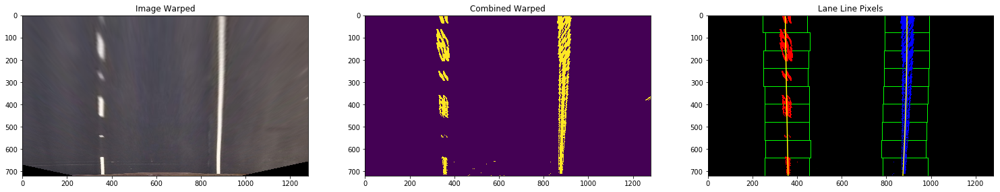

Fname  test_images/straight_lines2.jpg


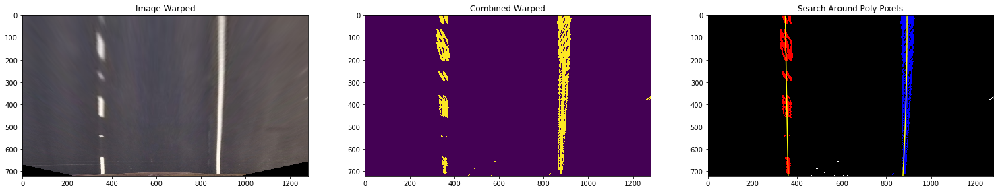

Fname  test_images/test1.jpg


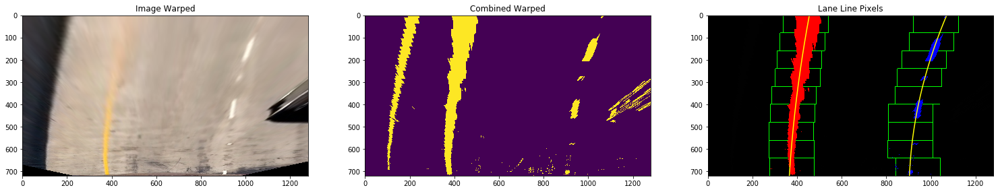

Fname  test_images/test1.jpg


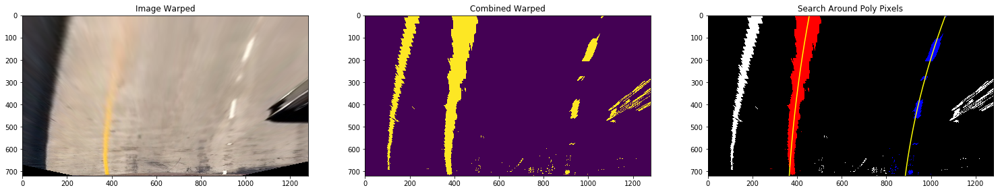

Fname  test_images/test2.jpg


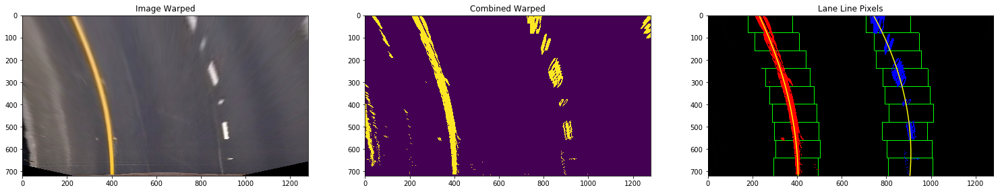

Fname  test_images/test2.jpg


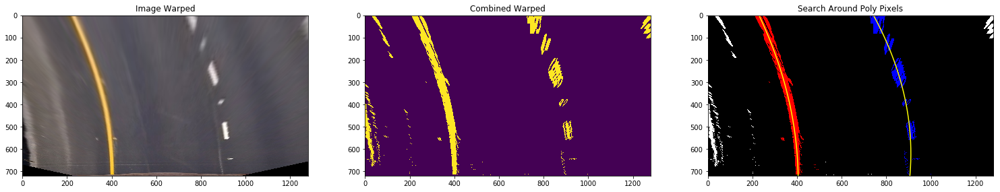

Fname  test_images/test3.jpg


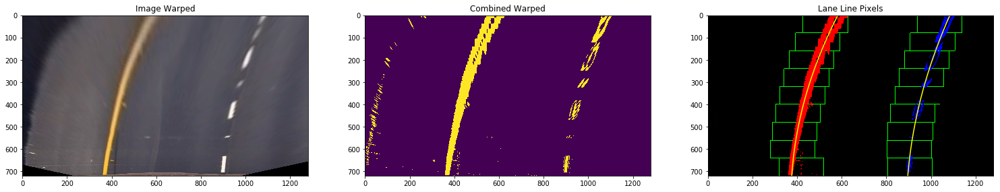

Fname  test_images/test3.jpg


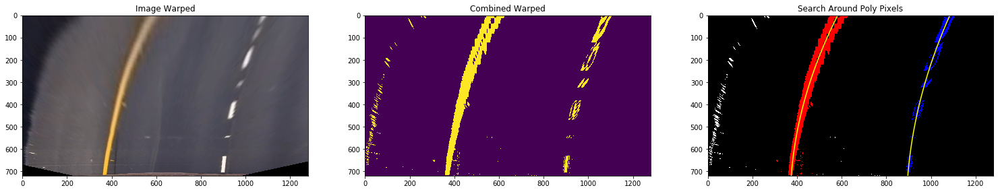

Fname  test_images/test4.jpg


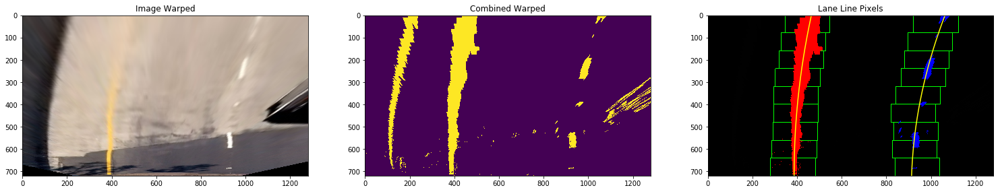

Fname  test_images/test4.jpg


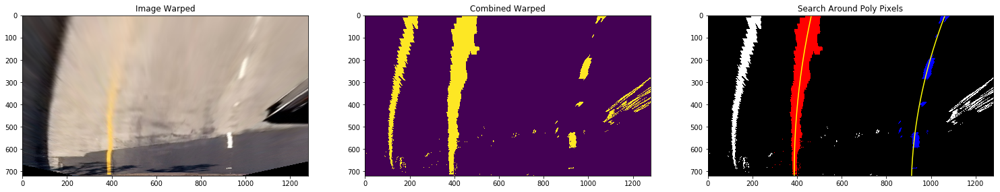

Fname  test_images/test5.jpg


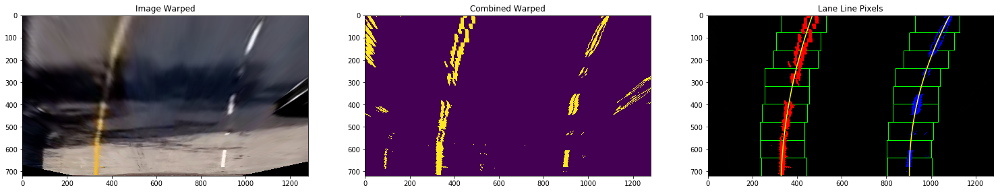

Fname  test_images/test5.jpg


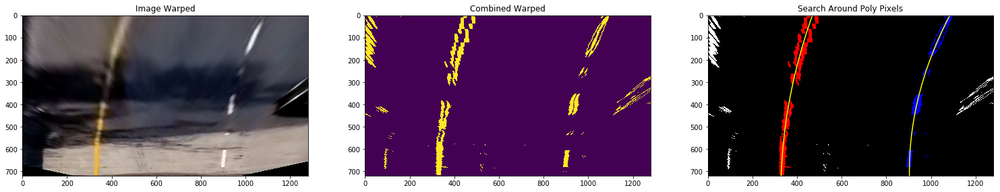

Fname  test_images/test6.jpg


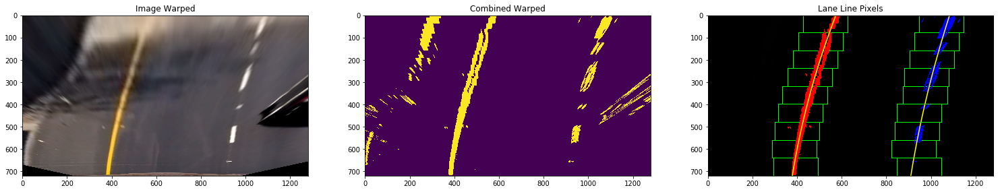

Fname  test_images/test6.jpg


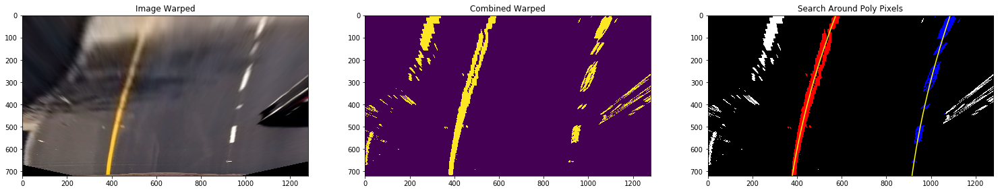

In [8]:
# Testing Histogram
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_histogram(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    roi = b.roi(combined)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
#     combined_warped = b.warp(roi) # Tried to cut a roi, but performance where not so good
    histogram = l.histogram(combined_warped)
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(image_warped)
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.plot(histogram)
    ax3.set_title('Histogram')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def test_find_lane_pixels(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
#     roi = b.roi(combined)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
#     combined_warped = b.warp(roi) # Tried to cut a roi, but performance where not so good
    l.find_lane_pixels(combined_warped, True)
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    outfname = fname.replace('test_images', f'{OUTPUT_FOLDER}/test_sliding_window')
    
    plt.imshow(l.out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.savefig(outfname)
    plt.clf()
    
    print("Fname ", fname)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(cv2.cvtColor(image_warped, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.imshow(l.out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Lane Line Pixels')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def test_search_around_poly(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
#     roi = b.roi(combined)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
#     combined_warped = b.warp(roi) # Tried to cut a roi, but performance where not so good
    l.search_around_poly(combined_warped, True)
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    print("Fname ", fname)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(cv2.cvtColor(image_warped, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.imshow(l.out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Search Around Poly Pixels')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
for index, fname in enumerate(images):
#     test_histogram(fname)
    test_find_lane_pixels(fname)
    test_search_around_poly(fname)

## 6. Determine the curvature of the lane and vehicle position with respect to center.

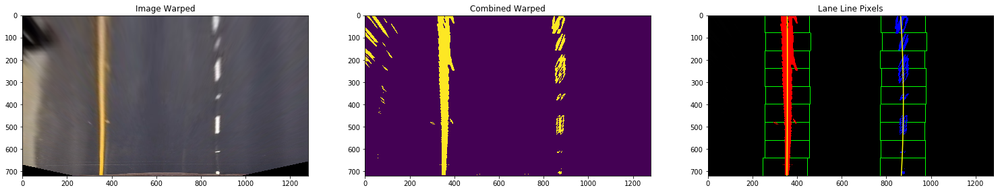

Fname  test_images/straight_lines1.jpg
Curvature =  9586
Distance =  0.154538150829
-----------------------


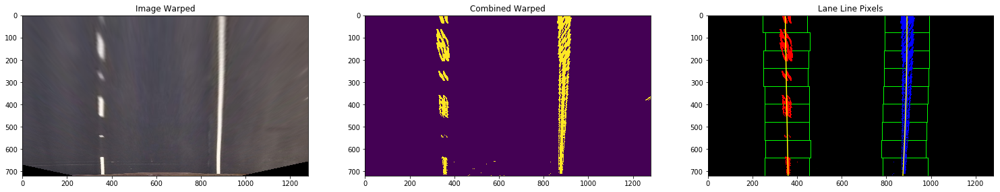

Fname  test_images/straight_lines2.jpg
Curvature =  22943
Distance =  0.121444190185
-----------------------


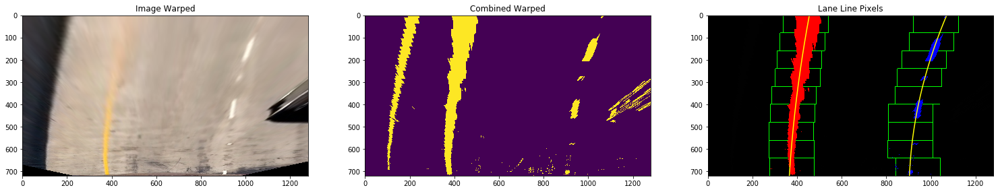

Fname  test_images/test1.jpg
Curvature =  1267
Distance =  0.0287170271785
-----------------------


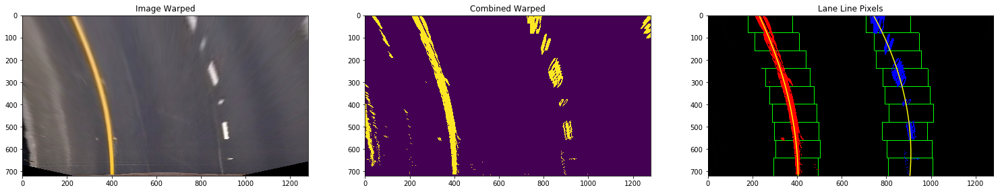

Fname  test_images/test2.jpg
Curvature =  447
Distance =  -0.0804333439366
-----------------------


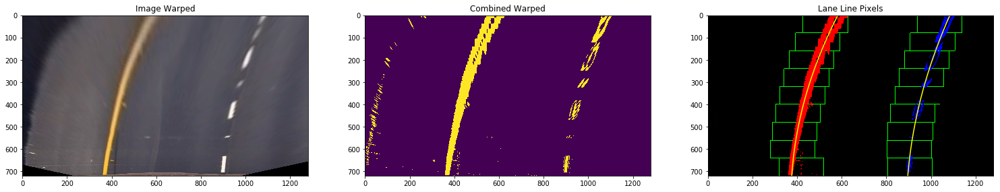

Fname  test_images/test3.jpg
Curvature =  590
Distance =  0.0194205537335
-----------------------


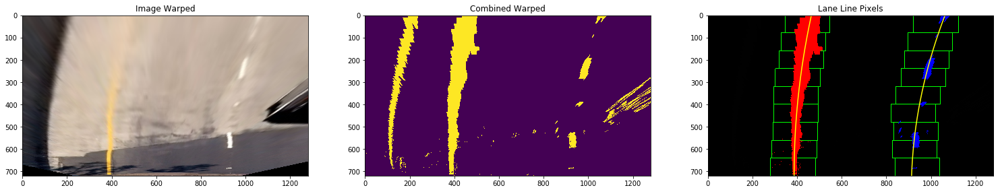

Fname  test_images/test4.jpg
Curvature =  878
Distance =  -0.0531197195939
-----------------------


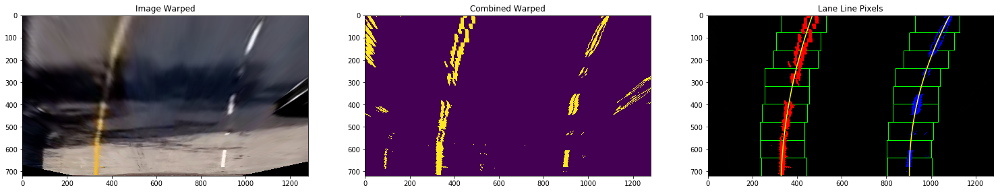

Fname  test_images/test5.jpg
Curvature =  593
Distance =  0.126326874237
-----------------------


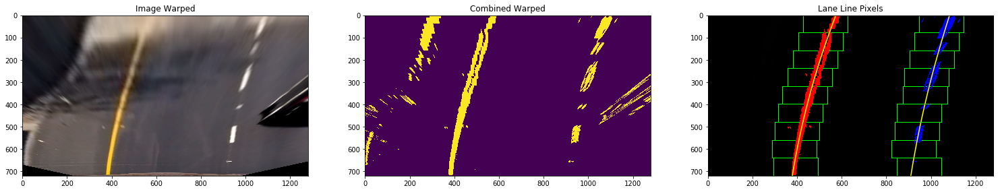

Fname  test_images/test6.jpg
Curvature =  1267
Distance =  -0.0234020876373
-----------------------


In [7]:
# Testing Histogram
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_curvature_car_distance(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
    l.find_lane_pixels(combined_warped, True)
    curvature = l.curvature()
    car_distance = l.car_center_distance()
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(cv2.cvtColor(image_warped, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.imshow(l.out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Lane Line Pixels')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    print("Fname ", fname)
    print("Curvature = ", int(curvature))
    print("Distance = ", car_distance)
    print("-----------------------")
    
for index, fname in enumerate(images):
    test_curvature_car_distance(fname)

## 7. Warp the detected lane boundaries back onto the original image

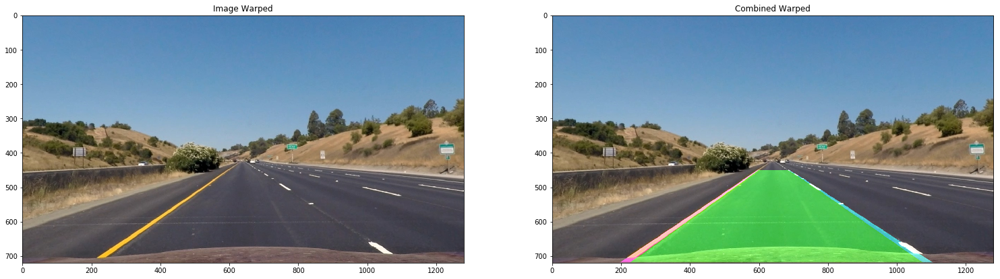

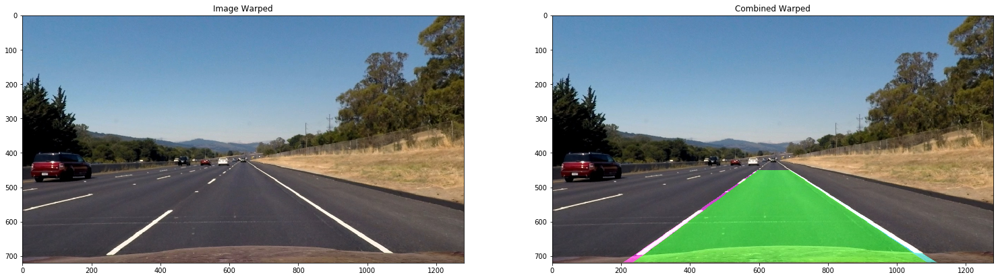

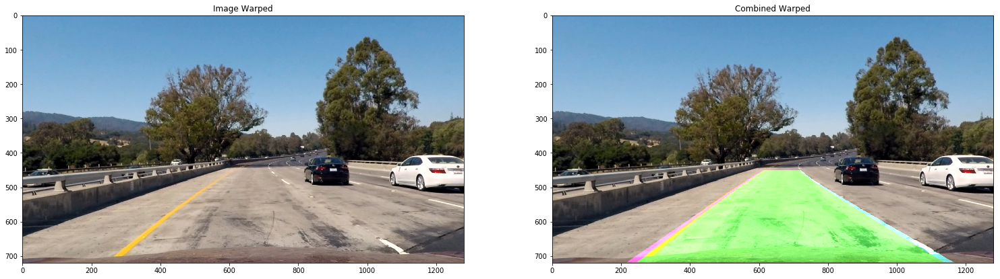

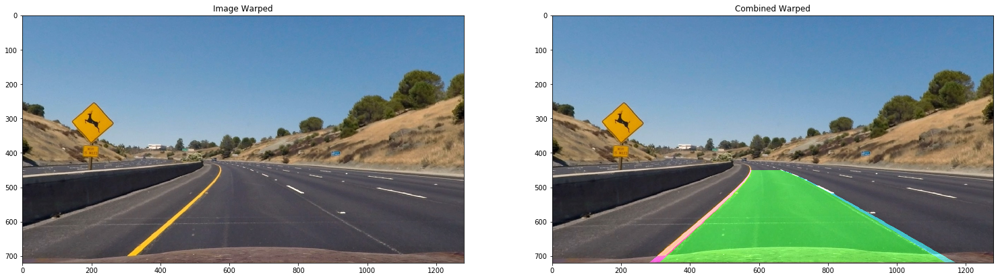

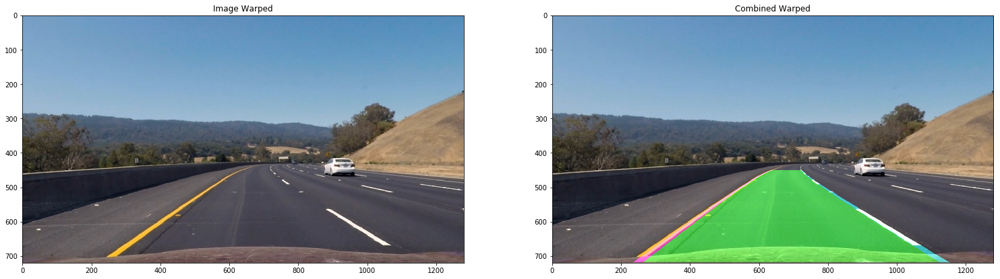

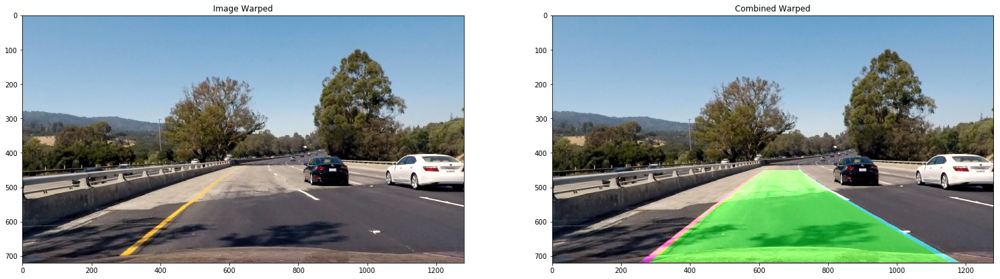

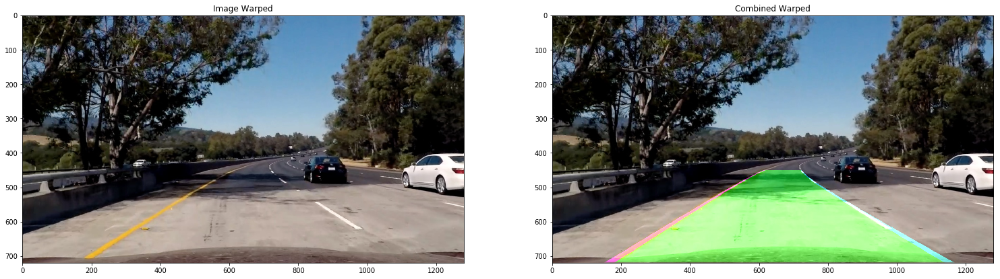

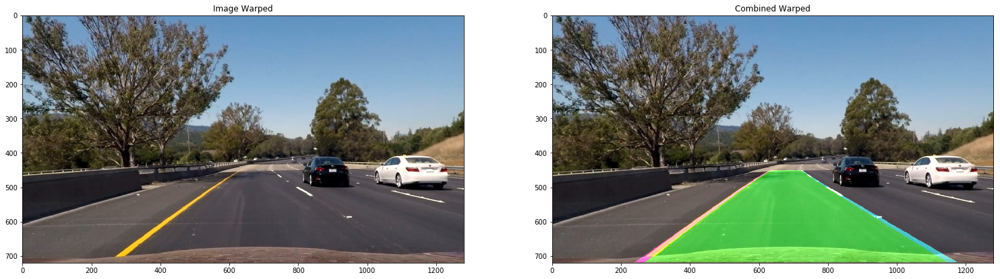

In [8]:
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_draw_lines_on_road(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
    l.find_lane_pixels(combined_warped, True)
    
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(image)
    ax1.set_title('Image Warped')
    ax2.imshow(draw_lines_on_road(image, combined_warped))
    ax2.set_title('Combined Warped')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
for index, fname in enumerate(images):
    test_draw_lines_on_road(fname)

## 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

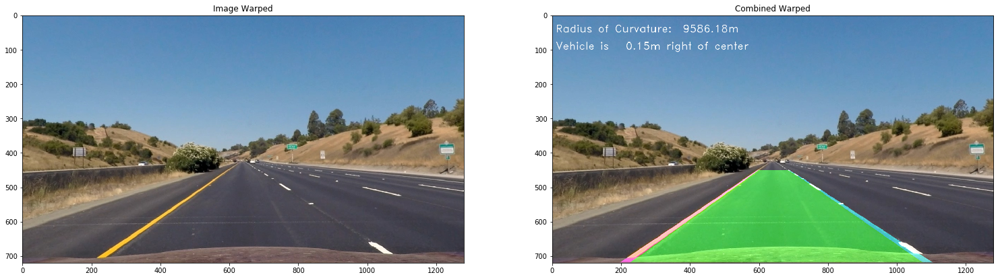

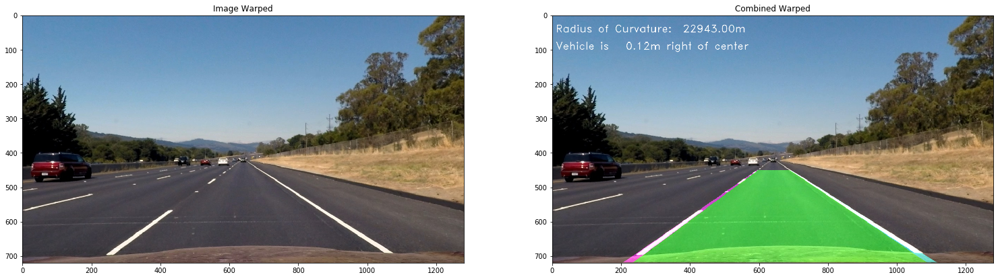

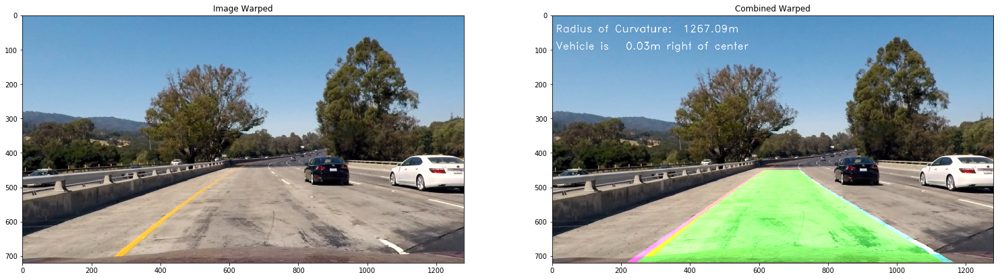

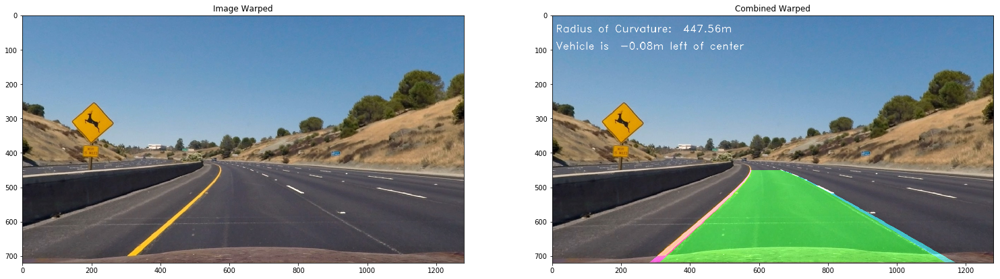

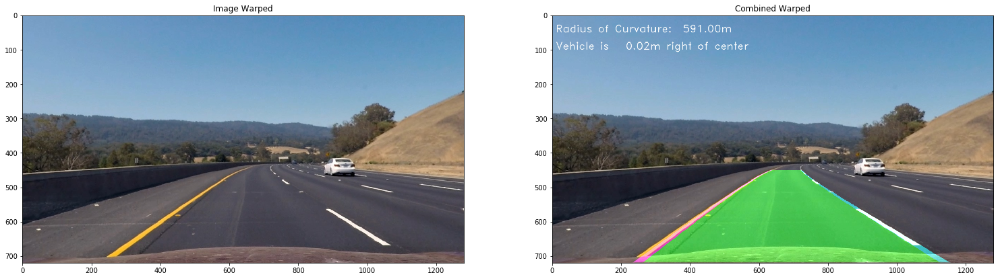

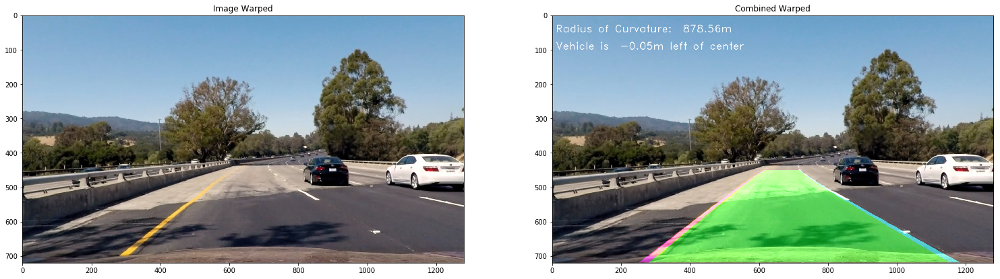

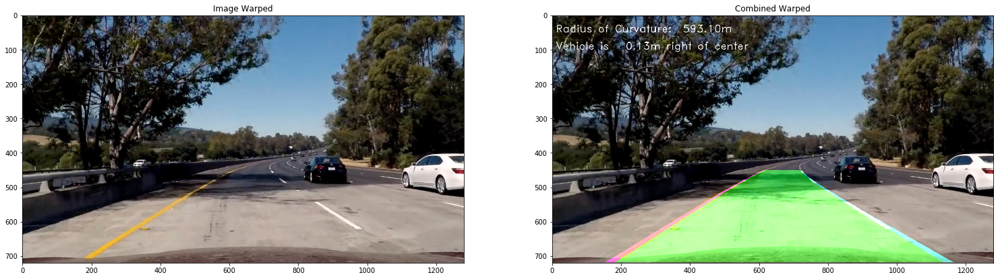

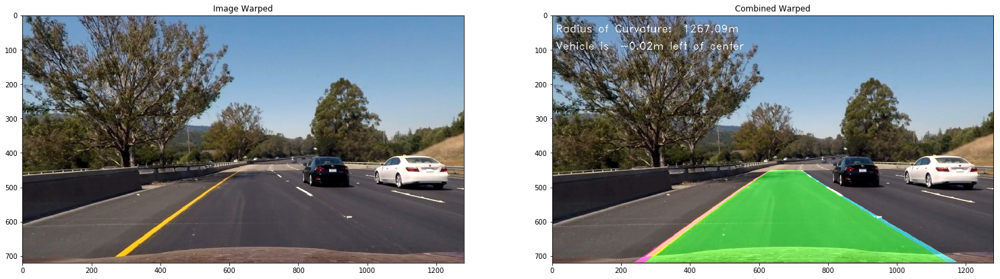

In [10]:
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_draw_lines_and_overlay_on_road(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
    l.find_lane_pixels(combined_warped, True)
    
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(image)
    ax1.set_title('Image Warped')
    temp = draw_lines_on_road(image, combined_warped)
    curvature = l.curvature()
    car_distance = l.car_center_distance()
    temp = draw_overlay(temp, curvature, car_distance)
    
    outfname = fname.replace('test_images', f'{OUTPUT_FOLDER}/test_final_output')
    cv2.imwrite(outfname, cv2.cvtColor(temp, cv2.COLOR_BGR2RGB))
    
    ax2.imshow(temp)
    ax2.set_title('Combined Warped')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
for index, fname in enumerate(images):
    test_draw_lines_and_overlay_on_road(fname)

## 9. Apply pipeline to video

In [11]:
c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def on_start():
    global l
    l = Lanes()

def pipeline(image):
    # Undistort
    image = c.undistort(image)
    # Apply thresholds
    combined = t.combine(image)
    # Bird-eye view
    combined_warped = b.warp(combined)
    # Find lanes
    l.findLanes(combined_warped)
    # Draw the lines back on the original image (plus the green road)
    image = draw_lines_on_road(image, combined_warped)
    # Calculate curvature and distance from center
    curvature = l.curvature()
    car_distance = l.car_center_distance()
    # Draw on image
    image = draw_overlay(image, curvature, car_distance)
    return image

In [12]:
import moviepy
from moviepy.editor import VideoFileClip
on_start()
video_output = 'project_video_output.mp4'
video_input = VideoFileClip('project_video.mp4')
processed_video = video_input.fl_image(pipeline)
%time processed_video.write_videofile(video_output, audio=False)

Imageio: 'ffmpeg.linux64' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg.linux64 (27.2 MB)
Downloading: 8192/28549024 bytes (0.0352256/28549024 bytes (1.2974848/28549024 bytes (3.41449984/28549024 bytes (5.1%1843200/28549024 bytes (6.5%2236416/28549024 bytes (7.8%2629632/28549024 bytes (9.2%3022848/28549024 bytes (10.63416064/28549024 bytes (12.03809280/28549024 bytes (13.34202496/28549024 bytes (14.74595712/28549024 bytes (16.14988928/28549024 bytes (17.55382144/28549024 bytes (18.95775360/28549024 bytes (20.26168576/28549024 bytes (21.66561792/28549024 bytes (23.06955008/28549024 bytes (24.47348224/28549024 bytes (25.77741440/28549024 bytes (27.18134656/28549024 bytes (28.58527872/28549024 bytes (29.98921088/28549024 bytes (31.29314304/28549024 bytes (32.69707520/28549024 bytes (34.010084352/28549024 bytes (35.3%10477568/28549024 bytes (36.7%10870784/28549024 bytes (38.1%11264000/28549024 b

100%|█████████▉| 1260/1261 [02:01<00:00, 10.33it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 1min 57s, sys: 12.6 s, total: 2min 9s
Wall time: 2min 3s


In [19]:
# import moviepy
# from moviepy.editor import VideoFileClip
# on_start()
# video_output = 'challenge_video_output.mp4'
# video_input = VideoFileClip('challenge_video.mp4')
# processed_video = video_input.fl_image(pipeline)
# %time processed_video.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [00:44<00:00, 10.71it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 43.1 s, sys: 5.04 s, total: 48.1 s
Wall time: 45.6 s


In [16]:
# import moviepy
# from moviepy.editor import VideoFileClip
# on_start()
# video_output = 'harder_challenge_video_output.mp4'
# video_input = VideoFileClip('harder_challenge_video.mp4')
# processed_video = video_input.fl_image(pipeline)
# %time processed_video.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [02:21<00:00,  8.63it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 2min 7s, sys: 17.7 s, total: 2min 25s
Wall time: 2min 22s
